In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import cv2

In [8]:
data = pd.read_csv('test_results/results.csv')
data.head

<bound method NDFrame.head of                            Image Path                          Logits Path  \
0     test_results/images/img_0_0.png   test_results/logits/logits_0_0.npy   
1     test_results/images/img_0_1.png   test_results/logits/logits_0_1.npy   
2     test_results/images/img_0_2.png   test_results/logits/logits_0_2.npy   
3     test_results/images/img_0_3.png   test_results/logits/logits_0_3.npy   
4     test_results/images/img_1_0.png   test_results/logits/logits_1_0.npy   
..                                ...                                  ...   
130  test_results/images/img_32_2.png  test_results/logits/logits_32_2.npy   
131  test_results/images/img_32_3.png  test_results/logits/logits_32_3.npy   
132  test_results/images/img_33_0.png  test_results/logits/logits_33_0.npy   
133  test_results/images/img_33_1.png  test_results/logits/logits_33_1.npy   
134  test_results/images/img_33_2.png  test_results/logits/logits_33_2.npy   

                            Mask 

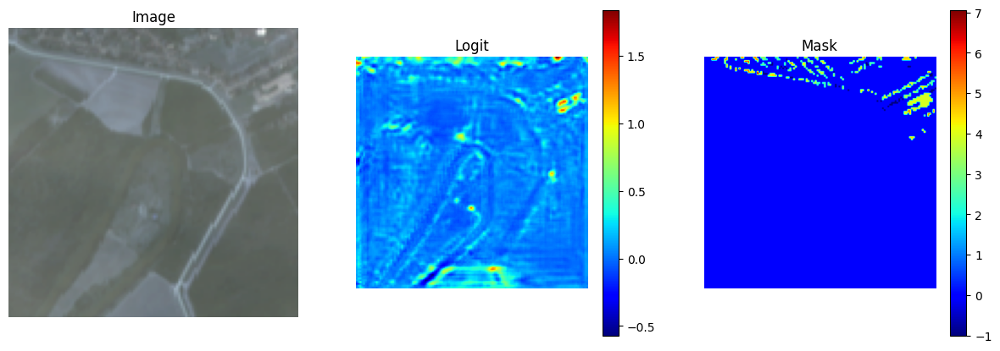

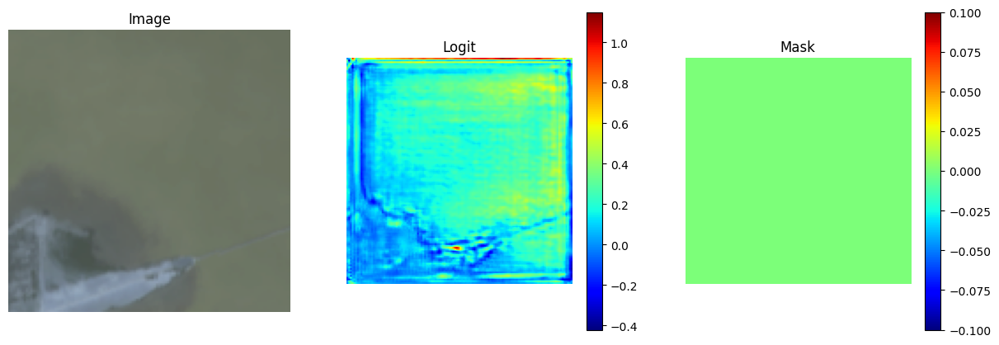

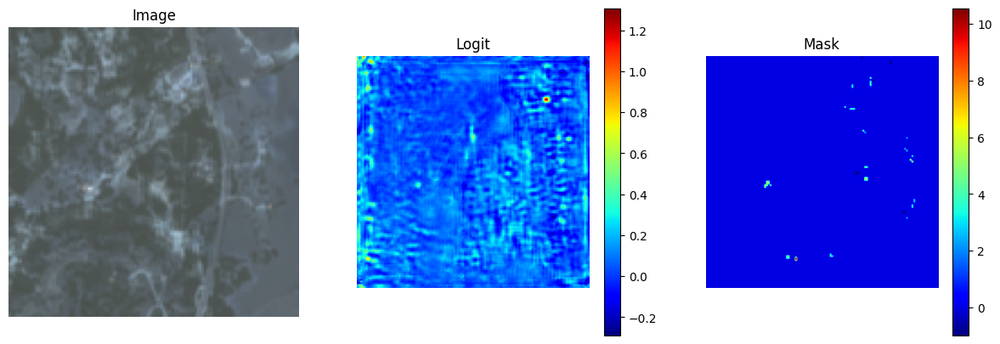

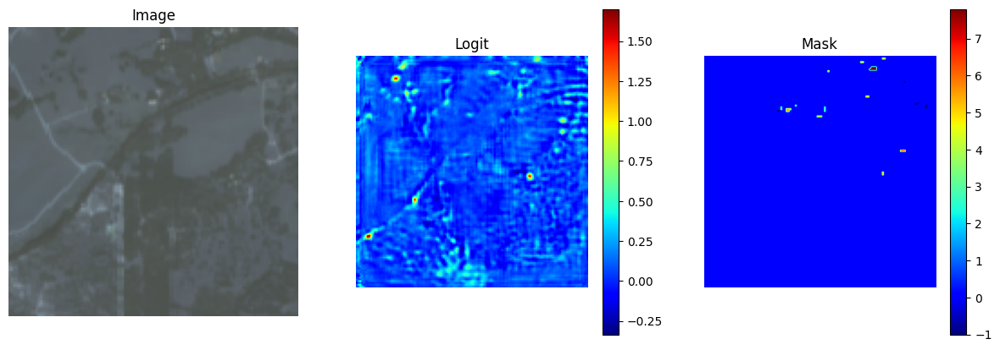

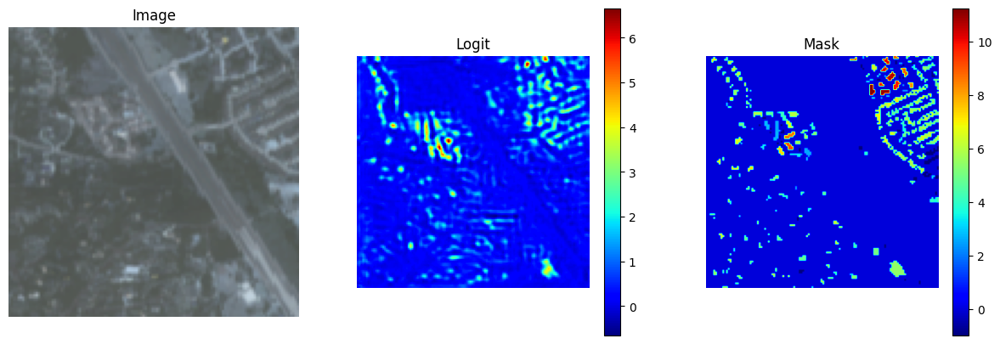

...

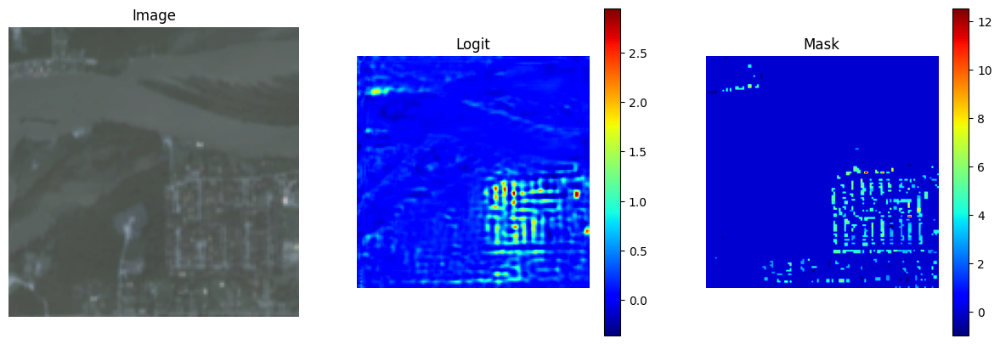

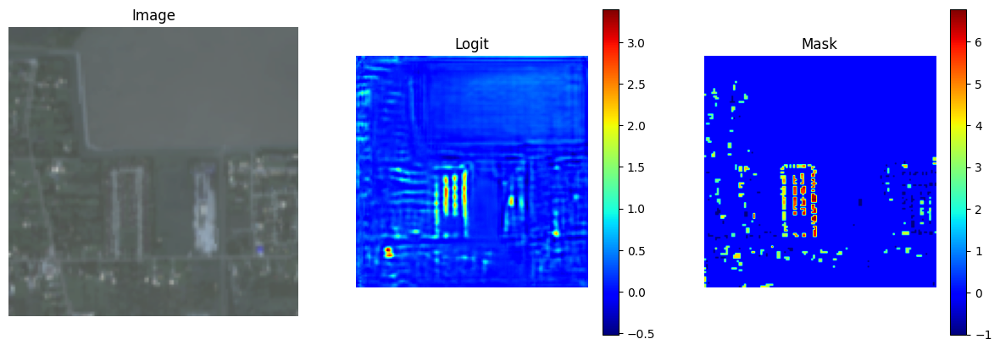

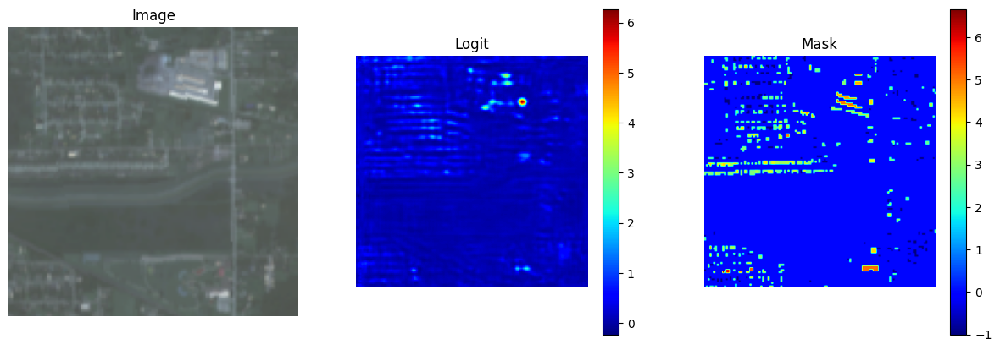

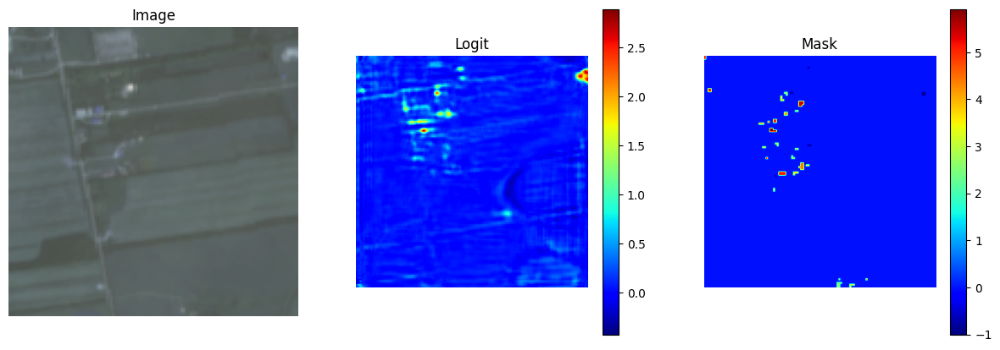

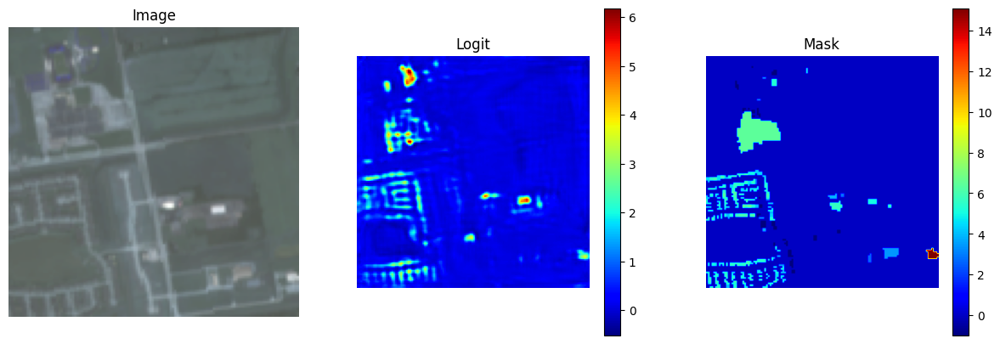

In [11]:
for index, row in data.iterrows():
    # Load the image, logit, and mask
    image = cv2.imread(row['Image Path'])
    logit = np.load(row['Logits Path'])
    mask = np.load(row['Mask Path'])  # Load mask as grayscale

    image = cv2.convertScaleAbs(image, alpha=1.5, beta=50)
    # Create a figure
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    # Display the image
    axs[0].imshow(image)
    axs[0].axis('off')  # Hide axes
    axs[0].set_title('Image')
    
    # Display the logit
    logit_display = axs[1].imshow(logit[0], cmap='jet')  # Change 'jet' to any colormap you prefer
    axs[1].axis('off')  # Hide axes
    axs[1].set_title('Logit')
    plt.colorbar(logit_display, ax=axs[1])  # Add a colorbar to the logit display
    
    # Display the mask
    mask_display = axs[2].imshow(mask, cmap='jet')  # Change 'gray' to any colormap you prefer
    axs[2].axis('off')  # Hide axes
    axs[2].set_title('Mask')
    plt.colorbar(mask_display, ax=axs[2])  # Add a colorbar to the mask display
    
    plt.show()  # Show the plot


